<a href="https://colab.research.google.com/github/ThanuMahee12/ayush-vision/blob/res-net/Algorithums/pretrained/ResNet50/ResNetFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ResNet 50

In [99]:
from google.colab import drive

In [100]:
drive.mount('/content/drive') # drive activate for Use

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install firebase-admin

## Imports

### Collab Imports

In [101]:
firebase_count=1

### Default Nessary Imports

In [102]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from datetime import date,datetime
import json
import csv

### Tensorflow Imports

In [103]:
import tensorflow as tf
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential,load_model
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense,Conv2D, MaxPooling2D, Flatten,GlobalAveragePooling2D,Dropout,Layer
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import firebase_admin
from firebase_admin import credentials,storage
from firebase_admin import firestore

## Variables

### Path variables

In [104]:
dataset_dir='/content/drive/MyDrive/AYUSHVISION/preTrained/final' #datasetbase dirctory

In [105]:
epochs=50

In [106]:
document_id=f'{datetime.now().strftime("%Y_%m_%d_%H")}_{epochs}'
storageLocation=f'training/res_net/'

In [107]:
working_dir=f'/content/drive/MyDrive/AYUSHVISION/ready/{document_id}'

In [108]:
dataset_train_dir=os.path.join(dataset_dir,'train')
dataset_test_dir=os.path.join(dataset_dir,'test')
dataset_val_dir=os.path.join(dataset_dir,'val')

### Genrator Variable

In [109]:
rescale=1/255

### Configration Variables

In [110]:
target_size=(224,224)
class_mode='categorical'
input_shape=(224,224,3)

### Model Variables

#### Number If Classes

In [111]:
no_of_classes=32

## Envirumentatl Setup

### Collab

## Firebase

In [112]:

if firebase_count==1:
  cred = credentials.Certificate("/content/drive/MyDrive/ServiceKey.json")
  firebase_admin.initialize_app(cred,{
    'storageBucket': 'ayush-vision-asw4gh.appspot.com'
})
firebase_count=firebase_count+1

ValueError: The default Firebase app already exists. This means you called initialize_app() more than once without providing an app name as the second argument. In most cases you only need to call initialize_app() once. But if you do want to initialize multiple apps, pass a second argument to initialize_app() to give each app a unique name.

In [113]:
db = firestore.client()

In [114]:
bucket = storage.bucket()

In [115]:
dcnn_ref = db.collection("training1").document('res-net')
doc = dcnn_ref.get()

In [116]:
if not doc.exists:
  doc_ref= db.collection("training1").document('res-net')
  doc_ref.set({'algorithum':'res-net','version':'1','mode':'classification','url':'res-net'})
else:
  doc_ref= dcnn_ref

## Validations

In [117]:
f'{dataset_train_dir} is Correct' if os.path.exists(dataset_train_dir) and os.path.isdir(dataset_train_dir) else f' {dataset_train_dir} is incorrect'


'/content/drive/MyDrive/AYUSHVISION/preTrained/final/train is Correct'

In [118]:
f'{dataset_test_dir} is Correct' if os.path.exists(dataset_test_dir) and os.path.isdir(dataset_train_dir) else f' {dataset_test_dir} is incorrect'


'/content/drive/MyDrive/AYUSHVISION/preTrained/final/test is Correct'

In [119]:
f'{dataset_val_dir} is Correct' if os.path.exists(dataset_val_dir) and os.path.isdir(dataset_val_dir) else f' {dataset_val_dir} is incorrect'

'/content/drive/MyDrive/AYUSHVISION/preTrained/final/val is Correct'

In [120]:
if not os.path.exists(working_dir):
  os.makedirs(working_dir)

## DataSet

### Image Genarator

In [121]:
train_data_genrator=image.ImageDataGenerator(
    rescale=1.0/255,
    rotation_range=40,          # Randomly rotate images up to 40 degrees
    width_shift_range=0.2,      # Shift images horizontally up to 20% of total width
    height_shift_range=0.2,     # Shift images vertically up to 20% of total height
    shear_range=0.2,            # Shear transformations (distortion along axes)
    zoom_range=0.2,             # Randomly zoom in or out
    horizontal_flip=True,       # Flip images horizontally
)

In [122]:
test_data_genrator=image.ImageDataGenerator(    rescale=1.0/255,            # Normalize pixel values to [0, 1]
    rotation_range=40,          # Randomly rotate images up to 40 degrees
    shear_range=0.2,            # Shear transformations (distortion along axes)
    zoom_range=0.2,             # Randomly zoom in or out
    horizontal_flip=True,       # Flip images horizontally
)

In [123]:
val_data_genrator=image.ImageDataGenerator(
    rescale=1.0/255,           # Normalize pixel values to [0, 1]
    rotation_range=40,          # Randomly rotate images up to 40 degrees

    zoom_range=0.2,             # Randomly zoom in or out
    horizontal_flip=True,       # Flip images horizontally

)

In [124]:
train_ds_gen=train_data_genrator.flow_from_directory(
    dataset_train_dir,
    target_size=(224,224),
    class_mode=class_mode
)

Found 11174 images belonging to 32 classes.


In [125]:
val_ds_gen=val_data_genrator.flow_from_directory(
    dataset_val_dir,
    target_size=target_size,
    class_mode=class_mode
)

Found 1598 images belonging to 32 classes.


In [126]:
test_ds_gen=test_data_genrator.flow_from_directory(
    dataset_test_dir,
    target_size=target_size,
    class_mode=class_mode
)

Found 3197 images belonging to 32 classes.


## Model


In [127]:
basicdata={'account':'vediothanu@gmail.com','user':"Thanush"}

In [128]:
basicdata['imageSize']=[224,224]
basicdata['project']=working_dir
basicdata['name']=document_id
basicdata['training_date']=datetime.now().strftime("%Y/%m/%d %H:%M:%S")
basicdata['filename']='ResNetFinal'


In [129]:
basicdata['names']=os.listdir(os.path.join(dataset_dir,'train'))

In [130]:
today_ref=doc_ref.collection("Pretrained").document(document_id)

In [131]:
today_ref.set(basicdata)

update_time {
  seconds: 1726138438
  nanos: 978823000
}

### Base Model MobileNetV3

In [132]:
ayush_resnet_50=ResNet50(input_shape=input_shape,  # We don't want the dense layers on top
                       input_tensor=None,
                        include_top=False,
                        weights='imagenet')

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


### Layers setup for Base Model

In [148]:
for layer in ayush_resnet_50.layers[:140]:
    layer.trainable = False

### Final Model

In [149]:
ayushVision_ResNet50_Model=Sequential()


In [150]:
ayushVision_ResNet50_Model.add(ayush_resnet_50)

#### Middle Layers

In [151]:
ayushVision_ResNet50_Model.add(GlobalAveragePooling2D())

In [152]:
ayushVision_ResNet50_Model.add(Dense(320, activation='relu'))

In [153]:
ayushVision_ResNet50_Model.add(Dropout(0.2))

In [154]:
ayushVision_ResNet50_Model.add(Dense(320, activation='relu'))

#### Last Layer

In [155]:
ayushVision_ResNet50_Model.add(Dense(no_of_classes, activation='softmax'))

In [156]:
today_training_colref=today_ref.collection('Train')

## Model Compile

#### Optimizer

In [158]:
optimizer = Adam(learning_rate=1e-4)

#### Compile

##### Variables

In [159]:
metrics=["accuracy"]
lossfn='categorical_crossentropy'

In [160]:
ayushVision_ResNet50_Model.compile(
    optimizer=optimizer,
    loss=lossfn,
    metrics=metrics)

In [161]:
todat_fit_train_ref=today_training_colref.document('fit')

In [163]:
todat_fit_train_ref.set({
    'epochs':epochs,
    'loss':lossfn,
    'optimizer':optimizer.get_config()

})

update_time {
  seconds: 1726138947
  nanos: 242428000
}

In [164]:
checkpoint = ModelCheckpoint(f'{working_dir}/resnet/{epochs}best_model.keras', monitor='val_accuracy', save_best_only=True, mode='max')
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

### Trainning

In [165]:
model_history=ayushVision_ResNet50_Model.fit(
    train_ds_gen,
    epochs=epochs,
    callbacks=[checkpoint,early_stopping],
    validation_data=val_ds_gen)

Epoch 1/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 181s 461ms/step - accuracy: 0.0627 - loss: 3.3754 - val_accuracy: 0.1076 - val_loss: 3.2271
Epoch 2/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 154s 430ms/step - accuracy: 0.1515 - loss: 2.9676 - val_accuracy: 0.1984 - val_loss: 2.9005
Epoch 3/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 153s 428ms/step - accuracy: 0.2029 - loss: 2.7339 - val_accuracy: 0.2128 - val_loss: 2.8444
Epoch 4/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 154s 429ms/step - accuracy: 0.2552 - loss: 2.5465 - val_accuracy: 0.2534 - val_loss: 2.5584
Epoch 5/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 151s 423ms/step - accuracy: 0.3070 - loss: 2.3397 - val_accuracy: 0.1827 - val_loss: 2.9800
Epoch 6/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 152s 427ms/step - accuracy: 0.3290 - loss: 2.2337 - val_accuracy: 0.3611 - val_loss: 2.1416
Epoch 7/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 155s 435ms/step - accuracy: 0.3882 - loss: 2.0784 - val_accuracy: 0.4174 - val_loss: 1.9644
Epoch 8/50
350/350 ━━━━━━━━━━━━━━━━━━━━ 153s 431ms/step - accuracy: 0.4105 -

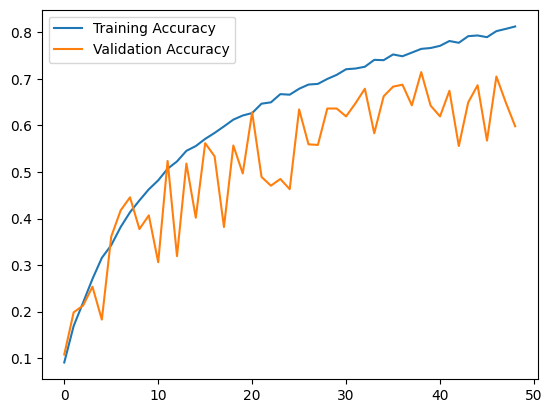

In [166]:
# Plot training history
plt.plot(model_history.history['accuracy'], label='Training Accuracy')
plt.plot(model_history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.savefig(f"{working_dir}/res_net{epochs}_model_accuracy.jpg")
plt.show()

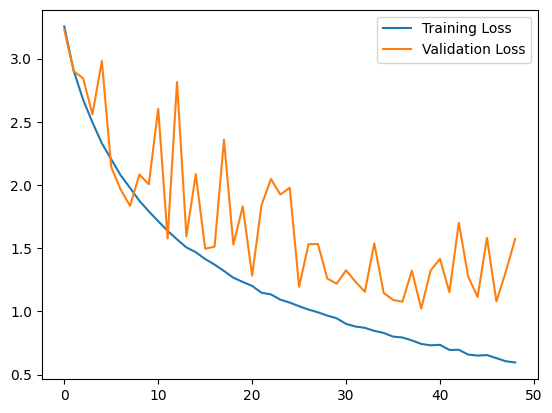

In [167]:
plt.plot(model_history.history['loss'], label='Training Loss')
plt.plot(model_history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.savefig(f"{working_dir}/res_net{epochs}_model_loss.jpg")
plt.show()

In [168]:
blob = bucket.blob(f"{storageLocation+document_id}/val/training_plot{document_id}.jpg")
blob.upload_from_filename(f'{working_dir}/res_net{epochs}_model_accuracy.jpg')
blob.make_public()

In [169]:
blobloss = bucket.blob(f"{storageLocation+document_id}/val/training_plot_loss{document_id}.jpg")
blobloss.upload_from_filename(f'{working_dir}/res_net{epochs}_model_loss.jpg')
blobloss.make_public()

In [170]:
validationref=today_ref.collection('Val')

In [171]:
valhistory_ref=validationref.document('history')
valaccuracy_ref=validationref.document('accuracy_plot')

In [172]:
valhistory_ref.set(
    model_history.history
)

update_time {
  seconds: 1726146671
  nanos: 139078000
}

In [173]:
valaccuracy_ref.set({
    'accuracy_url':blob.public_url,
    'loss_url':blobloss.public_url
})

update_time {
  seconds: 1726146675
  nanos: 593571000
}

### Evaluation

In [174]:
test_loss, test_accuracy = ayushVision_ResNet50_Model.evaluate(test_ds_gen)
print(f'Test Accuracy: {test_accuracy*100:.2f}%')

/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 409ms/step - accuracy: 0.6985 - loss: 1.0368
Test Accuracy: 70.97%


In [175]:
testref=today_ref.collection('Test')

In [176]:
test_accuracy_loss=testref.document('test_accuracy_lost')
test_accuracy_loss.set({
    'accuracy':test_accuracy,
    'loss':test_loss
})

update_time {
  seconds: 1726146738
  nanos: 485388000
}

In [177]:
modelref=today_ref.collection('Model')

In [178]:
ayushVision_ResNet50_Model.save(f'{working_dir}/res_net_{epochs}.h5',)

In [179]:
ayushVision_ResNet50_Model.save_weights(f'{working_dir}/res_net_{epochs}.weights.h5')

In [180]:
savemodel=modelref.document('model')

In [181]:
blob = bucket.blob(f"{storageLocation+document_id}/model/res_net_root_{epochs}.h5")
blob.upload_from_filename(f'{working_dir}/res_net_{epochs}.h5')
blob.make_public()
h5model=blob.public_url

In [182]:
savemodel.set({'model':h5model})

update_time {
  seconds: 1726146756
  nanos: 954321000
}

In [183]:
blob = bucket.blob(f"{storageLocation+document_id}/model/weights/res_net_weights_{epochs}.weights.h5")
blob.upload_from_filename(f'{working_dir}/res_net_{epochs}.weights.h5')
blob.make_public()
h5modelweights=blob.public_url

In [184]:
savemodel.update({
    'weights':h5modelweights
})

update_time {
  seconds: 1726146763
  nanos: 978426000
}

In [185]:
classnames=os.listdir(dataset_train_dir)

In [186]:
predictImagePath=os.path.join(dataset_dir,'predicts')

In [187]:
prdictsImages=list(map(lambda x:os.path.join(predictImagePath,x),os.listdir(predictImagePath)))

In [188]:
def load_and_preprocess_image(img_path, target_size=(224, 224)):
    img = image.load_img(img_path, target_size=target_size)  # Resize image to target size (224x224 by default)
    img_array = image.img_to_array(img)                      # Convert image to numpy array
    img_array = np.expand_dims(img_array, axis=0)            # Add batch dimension (required by the model)
    img_array /= 255.0                                       # Normalize the image to [0, 1] range
    return img_array

In [189]:
predictions = []
for img_path in prdictsImages:
    img_array = load_and_preprocess_image(img_path)
    preds = ayushVision_ResNet50_Model.predict(img_array)
    class_index = np.argmax(preds)
    confidence = preds[0, class_index]
    class_label = list(train_ds_gen.class_indices.keys())[class_index]
    predictions.append((img_path, class_label, confidence))

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━

In [190]:
os.makedirs(os.path.join(working_dir,"prdict"))

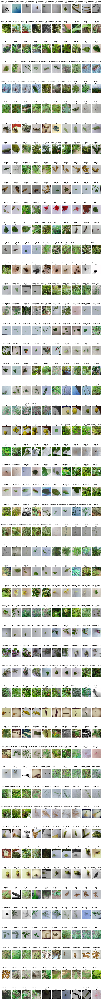

In [191]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Define a function to plot images
def plot_images(predictions, images_per_row=5):
    num_images = len(predictions)
    num_rows = (num_images + images_per_row - 1) // images_per_row

    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 3*num_rows))
    axes = axes.flatten()

    for img_idx, (img_path, class_label, confidence) in enumerate(predictions):
        img = mpimg.imread(img_path)
        axes[img_idx].imshow(img)
        axes[img_idx].set_title(f'{class_label}\n{confidence:.2f}')
        axes[img_idx].axis('off')

    # Hide any unused subplots
    for ax in axes[num_images:]:
        ax.axis('off')

    plt.tight_layout()
    plt.savefig(f'{working_dir}/prdict/predictImmage.png')
    plt.show()

# Plot images
plot_images(predictions, images_per_row=10)


In [192]:
blob = bucket.blob(f"{storageLocation+document_id}/predicts/res_net_prdicts_{epochs}.png")
blob.upload_from_filename(f'{working_dir}/prdict/predictImmage.png')
blob.make_public()
h5modelweights=blob.public_url

In [193]:
savemodel.update({'predicts':h5modelweights})

update_time {
  seconds: 1726147346
  nanos: 153352000
}

In [194]:
converter = tf.lite.TFLiteConverter.from_keras_model(ayushVision_ResNet50_Model)

# Optional: Optimize the model for size and speed
converter.optimizations = [tf.lite.Optimize.DEFAULT]

# Convert the model
tflite_model = converter.convert()

# Save the converted model
with open(f'{working_dir}/resnet{epochs}.tflite', 'wb') as f:
    f.write(tflite_model)

Saved artifact at '/tmp/tmpg5r_o3sr'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='keras_tensor_427')
Output Type:
  TensorSpec(shape=(None, 32), dtype=tf.float32, name=None)
Captures:
  140087902969296: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140085430840384: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140087892560176: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140087892569328: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140087892565808: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140087892572320: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140088170192160: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140088170184768: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140088170191456: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140088170196560: TensorSpec(shape=(), dtype=tf.resource, name=None)
  140088170

In [195]:
blob = bucket.blob(f"{storageLocation+document_id}/model/ayush_res_net_{epochs}.tflite")
blob.upload_from_filename(f'{working_dir}/resnet{epochs}.tflite')
blob.make_public()
h5modelweights=blob.public_url

In [196]:
savemodel.update({'tflite':h5modelweights})

update_time {
  seconds: 1726147771
  nanos: 301904000
}